First, let's import our dataset and the needed libraries for the exploration of the information provided by PVA:

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from math import ceil

# The dateutil module is an extension to the datetime module. One advantage is that we don't need to 
# pass any parsing code to parse a string.
from dateutil.parser import parse

#### ============ Functions ============

In [2]:
def columns_to_filter(key, end, start = 1):
    """
    Creating list using the key variable to help us filter the columns of the dataframe
    """
    
    columns = []
    
    for n in range(start, end+1):
        columns.append( key + str(n) )
    
    return columns

In [3]:
def plotter(series, filter_zero = True):
    """
    Plot the frequency of the percentages to find outliers, if needed, filter out the values equal to 0
    """
    
    if filter_zero:
        series = series[ series > 0 ]

    plt.bar(series.value_counts().index, series.value_counts().values, color='green')

    plt.show()

In [4]:
def percentage_validation(df, key, end, start = 1):
    """
    Add the percentages for a given set of columns.
    Mainly to validate if complementary set of columns get to 100%.
    """
    
    # Columns to filter dataframe
    columns = columns_to_filter(key, end, start)
    
    print(columns)
    
    return df[columns].sum(axis = 1) # Return the value of the sum per row.

In [5]:
def predominant(df, key, end, start = 1):
    """
    Getting the position where the dominant of the columns happen.
    """
    
    pred = []
    
    # Columns list
    columns = columns_to_filter(key, end, start)
    
    # Filtered DataFrame
    df_filtered = df[columns]
    
    # Max for each record given the columns above:
    dfmax = df[columns].max(axis = 1)
    
    for i in range( len(df) ):
        
        # Get the max value for row i
        max_ = dfmax.loc[i]
        
        # Get all the values in row i as a numpy array
        row = df_filtered.loc[i].values
        
        # Get the position where the max for row i happens
        position = np.where(row == max_)[0][0]
        
        # Append the value where you have the max without the need for encoding later
        pred.append( position + 1 )
    
    return pred

In [6]:
def hist_box_plotting( df, key, end, start = 1 ):
    """
    To explore metric variables using hist and boxplot 
    """
    
    columns = columns_to_filter(key, end, start)
    
    # Adjust the fig size acording to the number of variables
    n = 20
    if ( len(columns) < 4 ):
        n = 10
    elif ( len(columns) > 10 & len(columns) < 15 ):
        n = 50
    elif ( len(columns) > 15 ):
        n = 70
    
    # To create the two plots one at the side of the other
    columns = sorted(columns + columns)

    # Prepare figure. Create individual axes where each histogram will be placed
    fig, axes = plt.subplots( ceil(len(columns) / 2), 2, figsize=(20, n) )

    # Plot data
    # Iterate across axes objects and associate each histogram (hint: use the ax.hist() instead of plt.hist()):
    count = 0
    for ax, feat in zip(axes.flatten(), columns):
        
        if ( count % 2 == 0 ):
            ax.hist(df[feat])
            ax.set_title(feat, y=-0.13)
        else:
            sns.boxplot(x=df[feat], ax=ax)
        
        count += 1

    # Layout
    # Add a centered title to the figure:
    #title = "Numeric Variables' Histograms"

    #plt.suptitle(title)
    
    plt.show()

In [7]:
def check_pairplot(dfraw, key, start, end = 1):
    """
    Plot pairplots
    """
    
    columns = columns_to_filter(key, start, end)

    sns.pairplot(dfraw[columns], diag_kind="hist")

    # Layout
    plt.subplots_adjust(top=0.95)

    plt.show()

In [8]:
def reporter(df):
    """
    Create a dataframe with some important reporting features about another df.
    """
    
    df.replace("", np.nan, inplace=True)
    df.replace(" ", np.nan, inplace=True)

    df_info = pd.DataFrame(columns = ['Column', 'Dtype', 'Len', 'Unique', 'Unique_Val', 'Nan Val', '%NaN'])

    for i, col in enumerate(df.columns):
        df_info.loc[i] = [col, 
                          df[col].dtype, 
                          len(df[col]), 
                          df[col].nunique(),
                          df[col].unique(),
                          df[col].isna().sum(),
                          np.round( df[col].isna().sum() / len(df[col]), 4 )
                         ]

    df_info.set_index('Column', inplace = True)

    return df_info

In [9]:
def fix_proportion(df, values, helper, key, end, start = 1):
    """
    Fixes the variables in the df that add up over 100%.
        
        Values variable => is a list that contains all the values that add up over 100% (99,101,102...) and we want to fix.
    """
    
    columns = columns_to_filter(key, end, start)
    
    for v in values:
        a = helper[(helper == v)].index
        df.loc[a, columns] = (df[columns].loc[a]/v)*100

## Importing Data and Exploration:

Let's import the data

In [10]:
dfraw = pd.read_csv('donors.csv', index_col = 'Unnamed: 0')

dfraw.head()

C:\Users\maike\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3071: DtypeWarning: Columns (9,412) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


,ODATEDW,OSOURCE,TCODE,STATE,ZIP,MAILCODE,PVASTATE,DOB,NOEXCH,RECINHSE,...,AVGGIFT,CONTROLN,HPHONE_D,RFA_2R,RFA_2F,RFA_2A,MDMAUD_R,MDMAUD_F,MDMAUD_A,GEOCODE2
0,2009-01-01,GRI,0,IL,61081,,,1957-12-01,0,,...,7.741935,95515,0,L,4,E,X,X,X,C
1,2014-01-01,BOA,1,CA,91326,,,1972-02-01,0,,...,15.666667,148535,0,L,2,G,X,X,X,A
2,2010-01-01,AMH,1,NC,27017,,,NaN,0,,...,7.481481,15078,1,L,4,E,X,X,X,C
3,2007-01-01,BRY,0,CA,95953,,,1948-01-01,0,,...,6.812500,172556,1,L,4,E,X,X,X,C
4,2006-01-01,,0,FL,33176,,,1940-01-01,0,X,...,6.864865,7112,1,L,2,F,X,X,X,A


Creating variables for the type of columns:

In [11]:
# Dividing by types of columns:

basic_personal_features = ['ODATEDW', 'OSOURCE', 'TCODE', 'STATE', 'MAILCODE', 'PVASTATE', 'NOEXCH', 'RECINHSE', 'RECP3', \
                           'RECPGVG', 'RECSWEEP', 'MDMAUD', 'DOMAIN', 'HOMEOWNR', 'CHILD03', 'CHILD07', 'CHILD12', 'CHILD18' ,\
                           'GENDER', 'WEALTH1', 'HIT']

#NUMCHLD                     NUMBER OF CHILDREN
#INCOME                      HOUSEHOLD INCOME


# DOB: Date of birth (YYMM, Year/Month format.)

pastmail_offers_features = ['MBCRAFT', 'MBGARDEN', 'MBBOOKS', 'MBCOLECT', 'MAGFAML', 'MAGFEM', 'MAGMALE', 'PUBGARDN', \
                            'PUBCULIN', 'PUBHLTH', 'PUBDOITY', 'PUBNEWFN', 'PUBPHOTO', 'PUBOPP']

donor_info_features = ['DATASRCE', 'MALEMILI', 'MALEVET', 'VIETVETS', 'WWIIVETS', 'LOCALGOV', 'STATEGOV', 'FEDGOV', 'SOLP3',\
                       'SOLIH', 'MAJOR', 'WEALTH2', 'GEOCODE']

interests_features = ['COLLECT1', 'VETERANS', 'BIBLE', 'CATLG', 'HOMEE', 'PETS', 'CDPLAY', 'STEREO', 'PCOWNERS', 'PHOTO',\
                     'CRAFTS', 'FISHER', 'GARDENIN', 'BOATS', 'WALKER', 'KIDSTUFF', 'CARDS', 'PLATES', 'LIFESRC']

# PEPSTRFL = Indicates PEP Star RFA Status
        # blank = Not considered to be a PEP Star
        # 'X'   = Has PEP Star RFA Status

# Neighborhood data variables

# RFA (RECENCY/FREQUENCY/AMOUNT)
dates_promotion_features = columns_to_filter('ADATE_', 24, 2)
rfa_promotion_features = columns_to_filter('RFA_', 24, 2)

# The following fields are summary variables from the promotion history file.
summary_features = ['CARDPROM', 'MAXADATE', 'NUMPROM', 'CARDPM12', 'NUMPRM12']

#The following fields are from the giving history file
date_received_gift_features = columns_to_filter('RDATE_', 24, 3)
money_received_gift_features = columns_to_filter('RAMNT_', 24, 3)

#The following fields are summary variables from the giving history file.

summary_features = ['RAMNTALL', 'NGIFTALL', 'CARDGIFT', 'MINRAMNT', 'MINRDATE', 'MAXRAMNT', 'MAXRDATE', 'LASTGIFT', \
                    'LASTDATE', 'FISTDATE', 'NEXTDATE', 'TIMELAG', 'AVGGIFT']

# Control Features
control_features = ['CONTROLN', 'HPHONE_D']

# RFA Control features
rfa_control_features = ['RFA_2R', 'RFA_2F', 'RFA_2A', 'MDMAUD_R', 'MDMAUD_F', 'MDMAUD_A']

# GEOCODE2

In [12]:
# Creating a copy of the data:
df = dfraw.copy()

Since we're dealing with a big dataset, 475 columns, let's get a look of the columns in the dataframe along with some details about each of them using our function defined above:

In [13]:
df_info = reporter(df)

df_info.head()

,Dtype,Len,Unique,Unique_Val,Nan Val,%NaN
Column,,,,,,
ODATEDW,object,95412,54,"[2009-01-01, 2014-01-01, 2010-01-01, 2007-01-0...",0,0.0000
OSOURCE,object,95412,895,"[GRI, BOA, AMH, BRY, nan, CWR, DRK, NWN, LIS, ...",928,0.0097
TCODE,int64,95412,55,"[0, 1, 2, 28, 3, 1002, 42, 4, 18, 980, 14, 280...",0,0.0000
STATE,object,95412,57,"[IL, CA, NC, FL, AL, IN, LA, IA, TN, KS, MN, U...",0,0.0000
ZIP,object,95412,19938,"[61081, 91326, 27017, 95953, 33176, 35603, 467...",0,0.0000


Let's check the columns with NaN values.

Using the .head and .tail method to help us, Let's see which columns are missing values and replace those accordingly:

In [14]:
df_info[df_info['Nan Val'] > 0].sort_values(by=['Nan Val'], ascending = False).shape

(154, 6)

In [15]:
df_info[df_info['Nan Val'] > 0].sort_values(by=['Nan Val'], ascending = False).head(50)

,Dtype,Len,Unique,Unique_Val,Nan Val,%NaN
Column,,,,,,
RAMNT_5,float64,95412,9,"[nan, 50.0, 12.0, 8.0, 31.0, 10.0, 5.0, 13.0, ...",95403,0.9999
RDATE_5,object,95412,5,"[nan, 2016-04-01, 2017-03-01, 2016-07-01, 2018...",95403,0.9999
RECPGVG,object,95412,1,"[nan, X]",95298,0.9988
SOLP3,object,95412,4,"[nan, 00, 12, 01, 02]",95232,0.9981
RAMNT_3,float64,95412,29,"[nan, 50.0, 10.0, 2.0, 14.0, 20.0, 8.0, 7.0, 2...",95170,0.9975
RDATE_3,object,95412,14,"[nan, 2016-07-01, 2016-06-01, 2017-04-01, 2018...",95170,0.9975
RAMNT_4,float64,95412,32,"[nan, 10.0, 1.0, 15.0, 5.0, 2.0, 25.0, 20.0, 9...",95131,0.9971
RDATE_4,object,95412,21,"[nan, 2016-09-01, 2017-04-01, 2016-06-01, 2016...",95131,0.9971
MAJOR,object,95412,1,"[nan, X]",95118,0.9969


Replacements:

1) All the columns with the 'RAMNT' subkey as a name are related with the dollar ammount that the people donated to an specific campaign. Those values will be replaced for 0 and are stored in the previously defined list: 'money_received_gift_features'.

2) All the columns with the 'RFA' subkey as a name are related with recency and all nan values will be replaced by 0. Those values are stored in: 'rfa_promotion_features'.

3) All the columns with the 'RDATE' subkey as a name are related with the date the person received the gift and all nan values will be replaced by 0. Those values are stored in: 'date_received_gift_features'.

4) All the columns with the 'ADATE' subkey as a name are related with the date the the gift was sent and all nan values will be replaced by the mode first and then by 0 in those cases where NaN values are the ones that repeat the most. Those values are stored in: 'dates_promotion_features'.

5) Replacing all the interest features that are mostly binary. Those values are stored in: 'interests_features'.

6) Replacing all the past email features that are numeric, if the person hasn't respond to past offers then are assigned to 0. Those values are stored in: 'pastmail_offers_features'.


In [16]:
#1)
df[money_received_gift_features] = df[money_received_gift_features].fillna(0)

#2) Remove this
df[rfa_promotion_features] = df[rfa_promotion_features].fillna(0)

#3)
modes = df[date_received_gift_features].mode().loc[0]
df[date_received_gift_features] = df[date_received_gift_features].fillna(modes)
#df[date_received_gift_features] = df[date_received_gift_features].fillna(0)

#4)
modes = df[dates_promotion_features].mode().loc[0]
df[dates_promotion_features] = df[dates_promotion_features].fillna(modes)
#df[dates_promotion_features] = df[dates_promotion_features].fillna(0)

#5)
df[interests_features] = df[interests_features].fillna(0)
df[interests_features] = df[interests_features].replace('Y',1)

#6) 
df[pastmail_offers_features] = df[pastmail_offers_features].fillna(0)

Let's check the NaN values again:

In [17]:
df_info = reporter(df)

In [18]:
df_info[df_info['Nan Val'] > 0].sort_values(by=['Nan Val'], ascending = False).shape

(33, 6)

In [19]:
df_info[df_info['Nan Val'] > 0].sort_values(by=['Nan Val'], ascending = False).head(50)

,Dtype,Len,Unique,Unique_Val,Nan Val,%NaN
Column,,,,,,
RECPGVG,object,95412,1,"[nan, X]",95298,0.9988
SOLP3,object,95412,4,"[nan, 00, 12, 01, 02]",95232,0.9981
MAJOR,object,95412,1,"[nan, X]",95118,0.9969
CHILD03,object,95412,3,"[nan, M, F, B]",94266,0.9880
MAILCODE,object,95412,1,"[nan, B]",94013,0.9853
PVASTATE,object,95412,2,"[nan, P, E]",93954,0.9847
CHILD07,object,95412,3,"[nan, M, B, F]",93846,0.9836
RECSWEEP,object,95412,1,"[nan, X]",93795,0.9831
CHILD12,object,95412,3,"[nan, F, M, B]",93601,0.9810


The basic personal features list has values that contain discrepancies:

In [20]:
df_info_bp = df_info.loc[basic_personal_features]
df_info_bp[df_info_bp['Nan Val'] > 0]

,Dtype,Len,Unique,Unique_Val,Nan Val,%NaN
Column,,,,,,
OSOURCE,object,95412,895,"[GRI, BOA, AMH, BRY, nan, CWR, DRK, NWN, LIS, ...",928,0.0097
MAILCODE,object,95412,1,"[nan, B]",94013,0.9853
PVASTATE,object,95412,2,"[nan, P, E]",93954,0.9847
NOEXCH,object,95412,5,"[0, 1, X, 0, 1, nan]",7,0.0001
RECINHSE,object,95412,1,"[nan, X]",88709,0.9297
RECP3,object,95412,1,"[nan, X]",93395,0.9789
RECPGVG,object,95412,1,"[nan, X]",95298,0.9988
RECSWEEP,object,95412,1,"[nan, X]",93795,0.9831
DOMAIN,object,95412,16,"[T2, S1, R2, S2, T1, R3, U1, C2, C1, U3, nan, ...",2316,0.0243


Replacements:

In [21]:
# OSOURCE:
mode = df.OSOURCE.mode().loc[0]
df.OSOURCE.replace(np.nan, mode, inplace = True)

# MAILCODE
df.MAILCODE.replace(np.nan, 0, inplace = True)
df.MAILCODE.replace('B', 1, inplace = True)

#PVASTATE
df.PVASTATE.replace(np.nan, 0, inplace = True)

# NOEXCH
replacement = {np.nan: 0, '1': 1, '0': 0, 'X': 0}
df.NOEXCH.replace(replacement, regex=True, inplace = True)

# Several columns with the same unique values
for col in ['RECINHSE', 'RECP3', 'RECPGVG', 'RECSWEEP']:
    df[col].replace(np.nan, 0, inplace = True)
    df[col].replace('X', 1, inplace = True)

# Child Columns:
for col in ['CHILD03', 'CHILD07', 'CHILD12', 'CHILD18']:
    df[col].replace(np.nan, 0, inplace = True)

# GENDER:
replacement = { np.nan: 'U', 'C': 'U', 'A': 'U'}
df.GENDER.replace(replacement, regex=True, inplace = True)

# MAILCODE: G = good
df.MAILCODE.replace(np.nan, 'G', inplace = True)

# WEALTH1:
mode = df.WEALTH1.mode().loc[0]
df.WEALTH1.replace(np.nan, mode, inplace = True)

# HOMEOWNR: U = Unknown 
df.HOMEOWNR.replace(np.nan, 'U', inplace = True)

In [22]:
df_info = reporter(df)
df_info[df_info['Nan Val'] > 0].sort_values(by=['Nan Val'], ascending = False).shape

(18, 6)

In [23]:
df_info[df_info['Nan Val'] > 0].sort_values(by=['Nan Val'], ascending = False)

,Dtype,Len,Unique,Unique_Val,Nan Val,%NaN
Column,,,,,,
SOLP3,object,95412,4,"[nan, 00, 12, 01, 02]",95232,0.9981
MAJOR,object,95412,1,"[nan, X]",95118,0.9969
SOLIH,object,95412,7,"[nan, 12, 00, 02, 01, 04, 06, 03]",89212,0.9350
NUMCHLD,float64,95412,7,"[nan, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0]",83026,0.8702
GEOCODE,object,95412,7,"[nan, 02, 03, 05, 04, 14, 01, 12]",80168,0.8402
PEPSTRFL,object,95412,1,"[X, nan]",50143,0.5255
WEALTH2,float64,95412,10,"[5.0, 9.0, 1.0, 0.0, nan, 3.0, 2.0, 6.0, 8.0, ...",43823,0.4593
DOB,object,95412,847,"[1957-12-01, 1972-02-01, nan, 1948-01-01, 1940...",23883,0.2503
INCOME,float64,95412,7,"[nan, 6.0, 3.0, 1.0, 4.0, 2.0, 7.0, 5.0]",21286,0.2231


Let's do some manual replacements taking as a reference the dataframe above:

In [24]:
# Columns SOLIH and SOLP3, can be replaced by 13, since those can be solicited whenever 
df.SOLP3.replace(np.nan, '13', inplace = True)
df.SOLIH.replace(np.nan, '13', inplace = True)

#MAJOR + PEPSTRFL
for col in ['MAJOR','PEPSTRFL']:
    df[col].replace(np.nan, 0, inplace = True)
    df[col].replace('X', 1, inplace = True)

#NUMCHLD
df.NUMCHLD.replace(np.nan, 0, inplace = True)

#GEOCODE
df.GEOCODE.replace(np.nan, 0, inplace = True)

#WEALTH2: Wealth rating uses median family income and population statistics from each area to index relative wealth 
# within each state

Let's check again the NaN values:

In [25]:
df_info = reporter(df)
df_info[df_info['Nan Val'] > 0].sort_values(by=['Nan Val'], ascending = False).shape

(12, 6)

In [26]:
df_info[df_info['Nan Val'] > 0].sort_values(by=['Nan Val'], ascending = False)

,Dtype,Len,Unique,Unique_Val,Nan Val,%NaN
Column,,,,,,
WEALTH2,float64,95412,10,"[5.0, 9.0, 1.0, 0.0, nan, 3.0, 2.0, 6.0, 8.0, ...",43823,0.4593
DOB,object,95412,847,"[1957-12-01, 1972-02-01, nan, 1948-01-01, 1940...",23883,0.2503
INCOME,float64,95412,7,"[nan, 6.0, 3.0, 1.0, 4.0, 2.0, 7.0, 5.0]",21286,0.2231
DATASRCE,object,95412,3,"[nan, 3, 1, 2]",21280,0.2230
NEXTDATE,object,95412,188,"[2010-03-01, 2015-04-01, 2011-01-01, 2007-11-0...",9973,0.1045
TIMELAG,float64,95412,68,"[4.0, 18.0, 12.0, 9.0, 14.0, 6.0, 8.0, 7.0, na...",9973,0.1045
DOMAIN,object,95412,16,"[T2, S1, R2, S2, T1, R3, U1, C2, C1, U3, nan, ...",2316,0.0243
GEOCODE2,object,95412,4,"[C, A, D, B, nan]",319,0.0033
MSA,float64,95412,298,"[0.0, 4480.0, 9340.0, 5000.0, 2030.0, 3960.0, ...",132,0.0014


The columns listed on the dataframe above are going to be replaced by the modes:

In [27]:
# Saving the index above as list:
mode_fixing = df_info[df_info['Nan Val'] > 0].sort_values(by=['Nan Val'], ascending = False).index.to_list()

for col in mode_fixing:
    mode = df[col].mode().loc[0]
    df[col] = df[col].replace(np.nan, mode)

df.reset_index(inplace = True, drop = True)

In [28]:
df_info = reporter(df)

df_info[df_info['Nan Val'] > 0].sort_values(by=['Nan Val'], ascending = False)

,Dtype,Len,Unique,Unique_Val,Nan Val,%NaN
Column,,,,,,


### Data Exploration:

Let's if the columns have complementary percentages for those that, are, by pva metadata definition, complementary.

We're going to do it in terms of percentages.

['POP90C1', 'POP90C2', 'POP90C3']


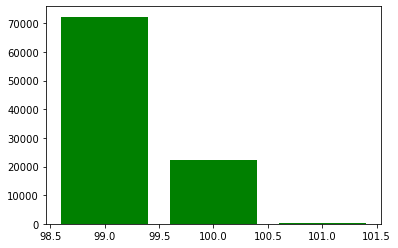

In [29]:
# POP90C1                     Percent Population in Urbanized Area
# POP90C2                     Percent Population Outside Urbanized Area
# POP90C3                     Percent Population Inside Rural Area

pop90c = percentage_validation(df, 'POP90C', 3)

plotter(pop90c)

In [30]:
# Fixing the values in the variables:
fix_proportion(df, [99, 101], pop90c, 'POP90C', 3)

In [31]:
# Verifying:
percentage_validation(df, 'POP90C', 3).value_counts()

['POP90C1', 'POP90C2', 'POP90C3']


100.0    94525
0.0        850
100.0       24
100.0       13
dtype: int64

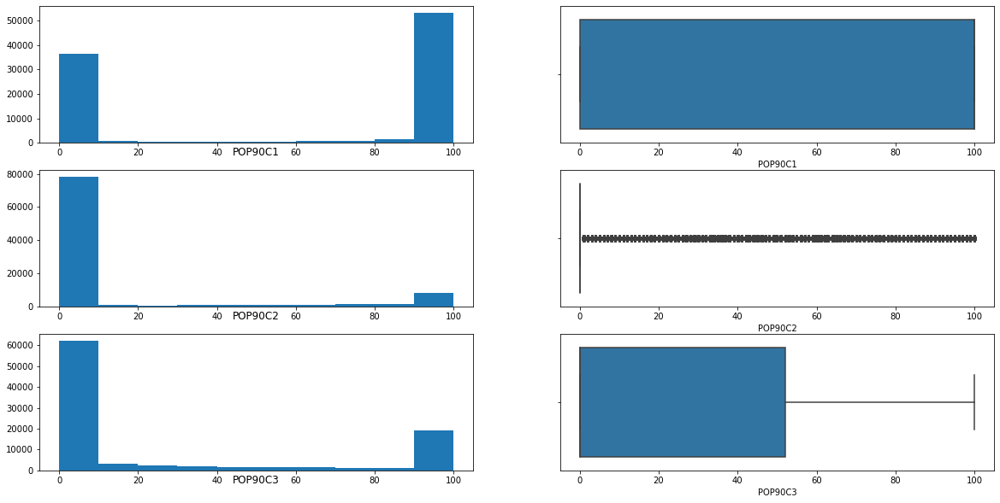

In [32]:
hist_box_plotting( df, 'POP90C', 3 )

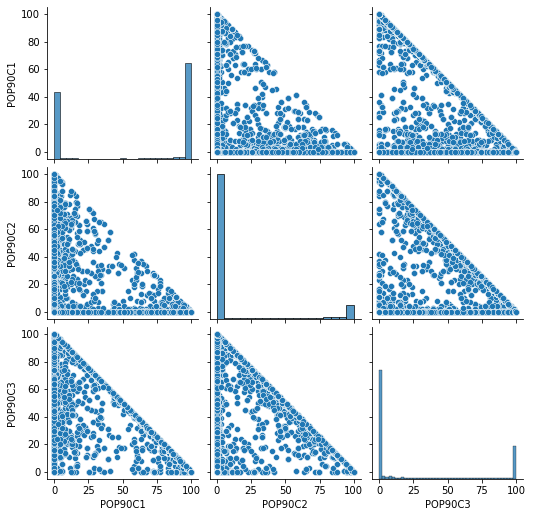

In [33]:
check_pairplot(df, 'POP90C', 3)

['POP90C4', 'POP90C5']


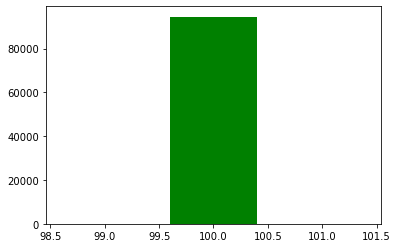

In [34]:
# POP90C4                     Percent Male
# POP90C5                     Percent Female

pop90c = percentage_validation(df, 'POP90C', 5, 4)

plotter(pop90c)

In [35]:
pop90c.value_counts()

100    94524
0        799
101       70
99        19
dtype: int64

In [36]:
# Scaling proportions:
fix_proportion(df, [99, 101], pop90c, 'POP90C', 5, 4)

In [37]:
# Verifying the scaling:
percentage_validation(df, 'POP90C', 5, 4).value_counts()

['POP90C4', 'POP90C5']


100.0    94613
0.0        799
dtype: int64

As you see above we have records that show 0% in terms of male/female proportion in the donor's neighborhood. Those records have to be dropped because they don't make sense:

In [38]:
# Variables for the indexes to drop
ind_drop = pop90c[(pop90c == 0)].index

# Dropping by index, and resetting the index
df.drop(index=ind_drop, inplace = True)
df.reset_index(inplace = True, drop = True)

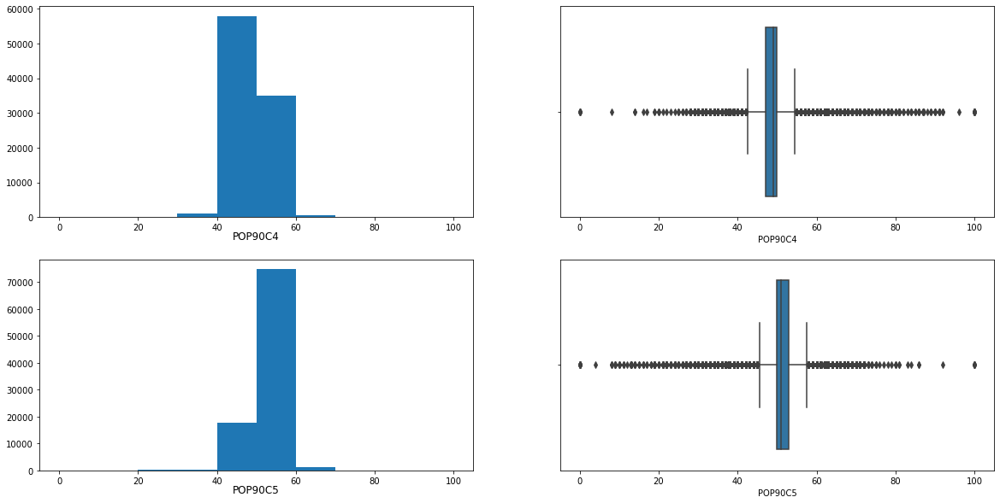

In [39]:
hist_box_plotting(df, 'POP90C', 5, 4)

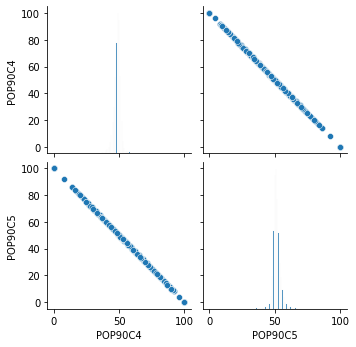

In [40]:
check_pairplot(df, 'POP90C', 5, 4)

['ETH1', 'ETH2', 'ETH3', 'ETH4', 'ETH5', 'ETH6', 'ETH7', 'ETH8', 'ETH9', 'ETH10', 'ETH11', 'ETH12', 'ETH13', 'ETH14', 'ETH15', 'ETH16']


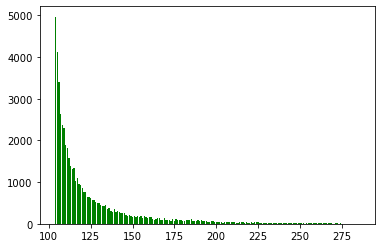

In [41]:
"""
ETH1                        Percent White
ETH2                        Percent Black
ETH3                        Percent Native American
ETH4                        Percent Pacific Islander/Asian
ETH5                        Percent Hispanic
ETH6                        Percent Asian Indian
ETH7                        Percent Japanese
ETH8                        Percent Chinese
ETH9                        Percent Philipino
ETH10                       Percent Korean
ETH11                       Percent Vietnamese
ETH12                       Percent Hawaiian
"""

eth = percentage_validation(df, 'ETH', 16)

eth = eth[ eth>103 ]
#print('Possible outliers:', len(eth.index) )
plotter(eth)

['ETH13', 'ETH14', 'ETH15', 'ETH16']


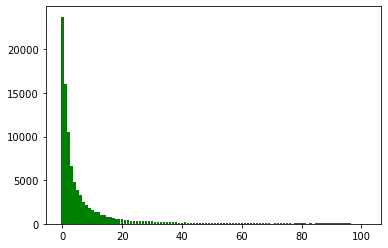

In [42]:
"""
ETH13                       Percent Mexican
ETH14                       Percent Puerto Rican
ETH15                       Percent Cuban
ETH16                       Percent Other Hispanic
"""

eth = percentage_validation(df, 'ETH', 16, 13)

plotter(eth, False)

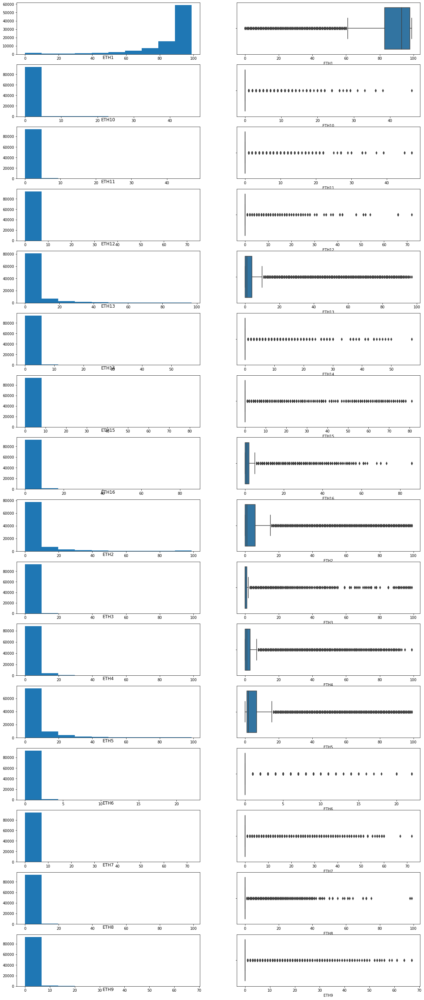

In [43]:
hist_box_plotting( df, 'ETH', 16 )

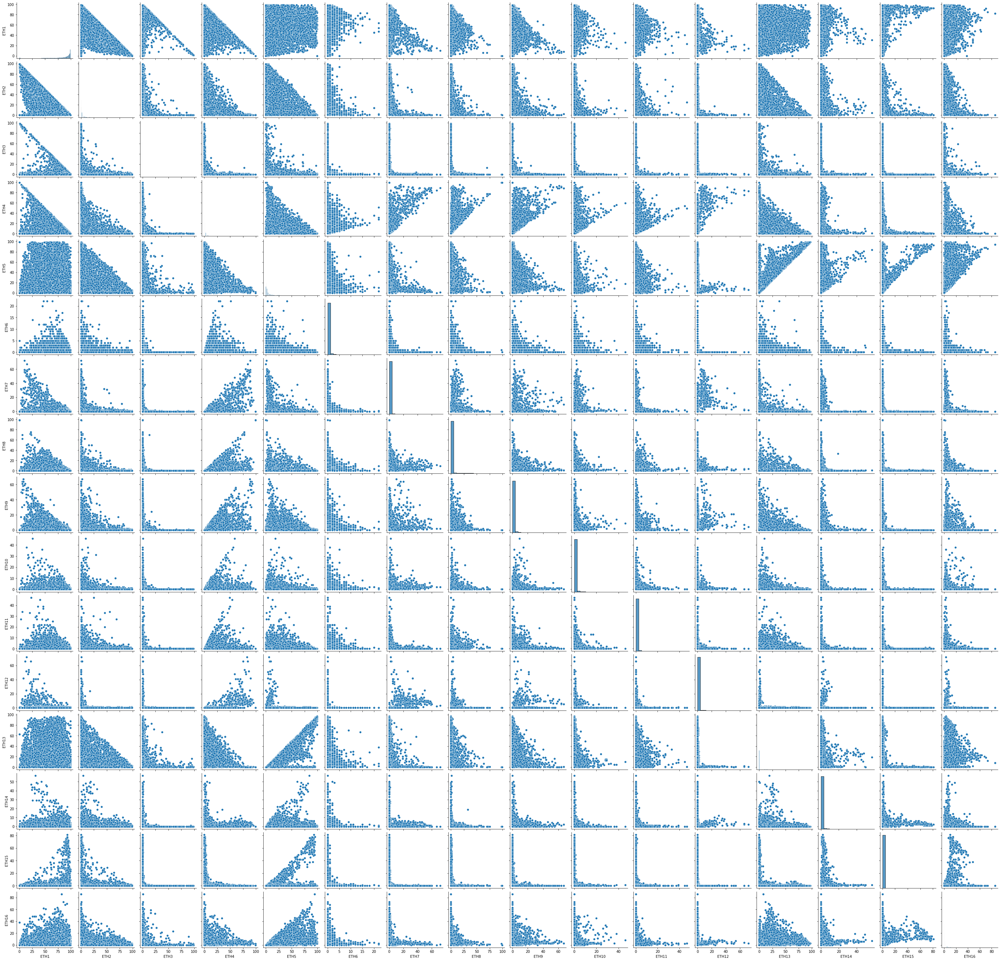

In [44]:
check_pairplot(dfraw, 'ETH', 16)

['AGE907']


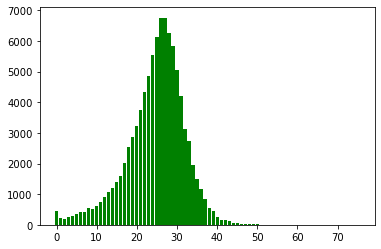

In [45]:
"""
AGE907                      Percent Population Under Age 18
"""
# AGE907 + CHIL1 + CHIL2 + CHIL3
minor = percentage_validation(df, 'AGE90', 7, 7)

plotter(minor, False)

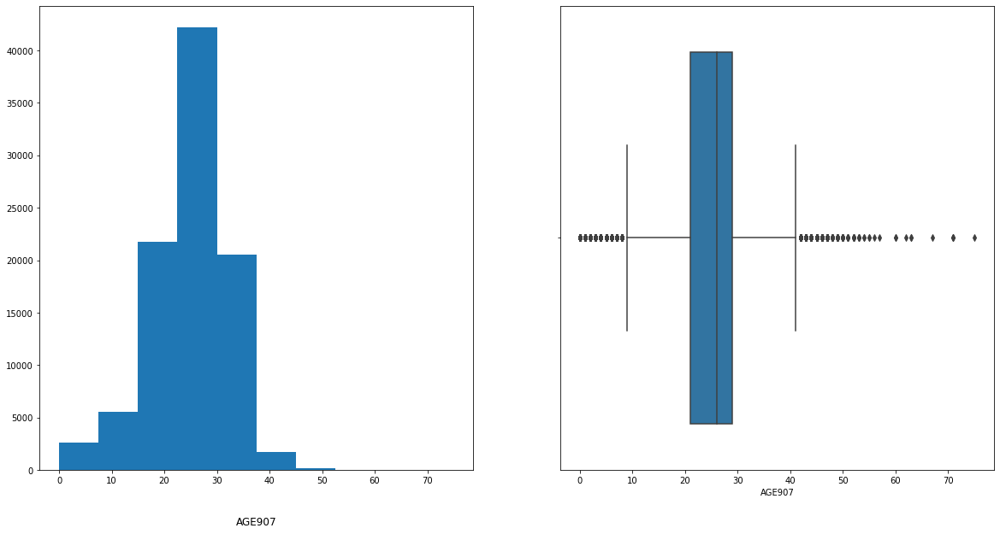

In [46]:
hist_box_plotting(df, 'AGE90', 7, 7)

['CHIL1', 'CHIL2', 'CHIL3']


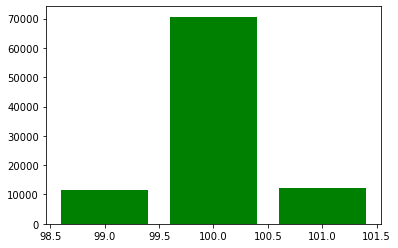

In [47]:
"""
CHIL1                       Percent Children Under Age 7
CHIL2                       Percent Children Age 7 - 13
CHIL3                       Percent Children Age 14-17
"""

child = percentage_validation(df, 'CHIL', 3)

plotter(child)

As we did before, for male/female neighborhoods, let's scale back the values of the neighborhoods close to 100%. In this case, it does make sense to have neighborhoods with 0% children.

In [48]:
child.value_counts()

100    70624
101    12127
99     11669
0        193
dtype: int64

In [49]:
fix_proportion(df, [99, 101], child, 'CHIL', 3)

In [50]:
percentage_validation(df, 'CHIL', 3).value_counts()

['CHIL1', 'CHIL2', 'CHIL3']


100.0    92424
100.0     1081
100.0      915
0.0        193
dtype: int64

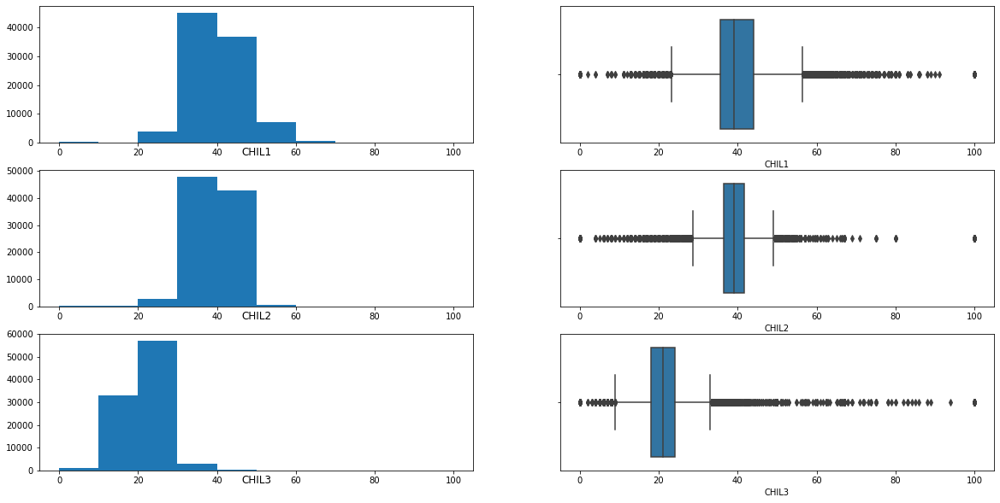

In [51]:
hist_box_plotting(df, 'CHIL', 3)

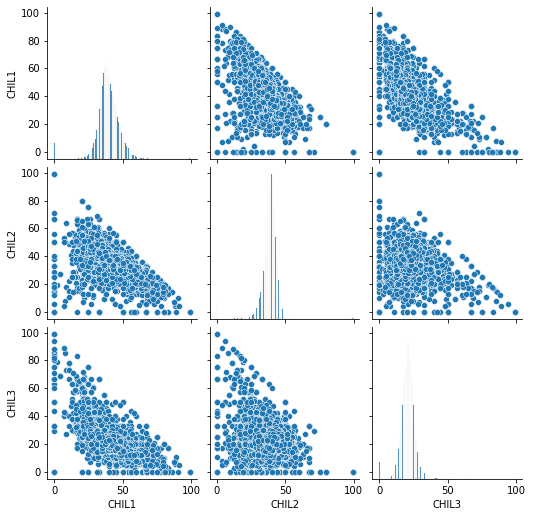

In [52]:
check_pairplot(dfraw, 'CHIL', 3)

['AGEC1', 'AGEC2', 'AGEC3', 'AGEC4', 'AGEC5', 'AGEC6', 'AGEC7']


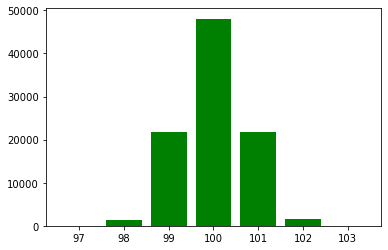

In [53]:
"""
AGEC1                       Percent Adults Age 18-24
AGEC2                       Percent Adults Age 25-34
AGEC3                       Percent Adults Age 35-44
AGEC4                       Percent Adults Age 45-54
AGEC5                       Percent Adults Age 55-64
AGEC6                       Percent Adults Age 65-74
AGEC7                       Percent Adults Age >= 75
"""
adults = percentage_validation(df, 'AGEC', 7)

plotter(adults)

By seen the bar plot above we can notice that several records are outside 100% when checked, but those values are not insignificant, therefore, let's scale to not loose important information:

In [54]:
adults.value_counts()

100    48075
101    21782
99     21716
102     1586
98      1442
103        9
97         3
dtype: int64

In [55]:
fix_proportion(df, [97, 98, 99, 101, 102, 103], adults, 'AGEC', 7)

In [56]:
adults = percentage_validation(df, 'AGEC', 7)

adults.value_counts()

['AGEC1', 'AGEC2', 'AGEC3', 'AGEC4', 'AGEC5', 'AGEC6', 'AGEC7']


100.0    78528
100.0    12508
100.0     3021
100.0      486
100.0       70
dtype: int64

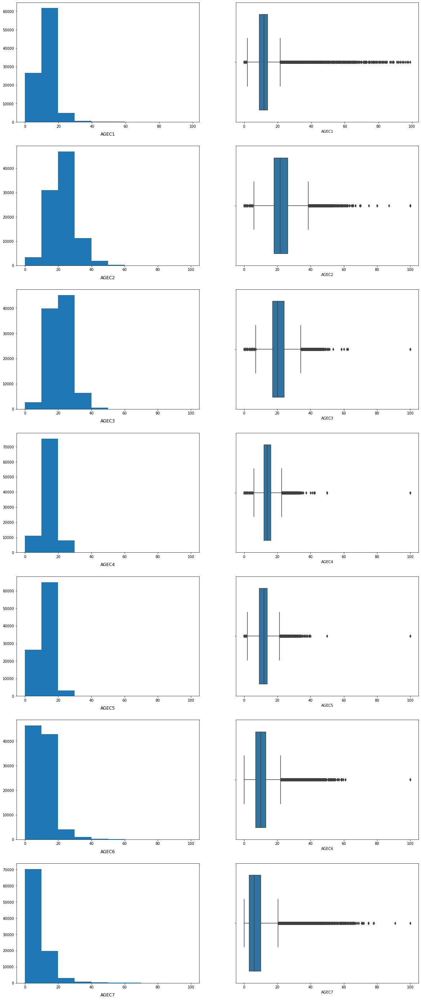

In [57]:
hist_box_plotting(df, 'AGEC', 7)

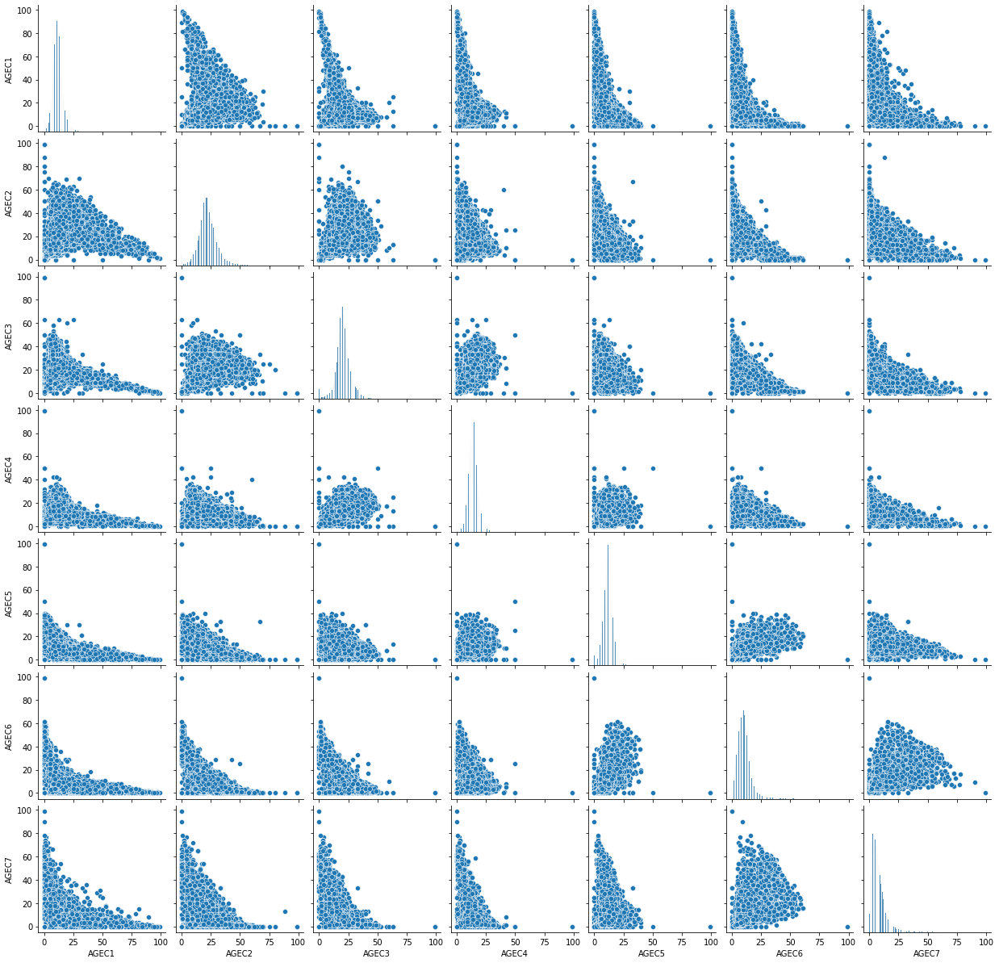

In [58]:
check_pairplot(dfraw, 'AGEC', 7)

['CHILC1', 'CHILC2', 'CHILC3', 'CHILC4', 'CHILC5']


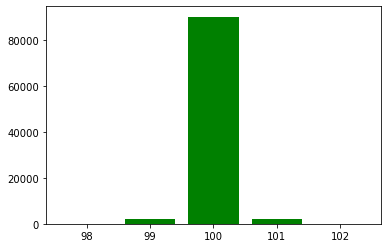

In [59]:
"""
CHILC1                      Percent Children Age <=2
CHILC2                      Percent Children Age 3-5
CHILC3                      Percent Children Age 6-11
CHILC4                      Percent Children Age 12-15
CHILC5                      Percent Children Age 16-18
"""
children = percentage_validation(df, 'CHILC', 5)

plotter(children)

In [60]:
children.value_counts()

100    90343
101     2033
99      1995
0        193
102       26
98        23
dtype: int64

In [61]:
fix_proportion(df, [98, 99, 101, 102], children, 'CHILC', 5)

In [62]:
percentage_validation(df, 'CHILC', 5).value_counts()

['CHILC1', 'CHILC2', 'CHILC3', 'CHILC4', 'CHILC5']


100.0    93901
100.0      336
0.0        193
100.0      179
100.0        4
dtype: int64

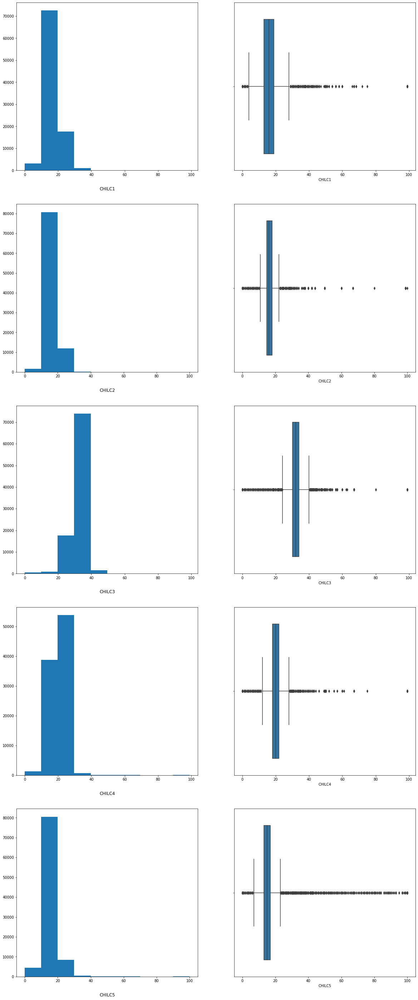

In [63]:
hist_box_plotting(df, 'CHILC', 5)

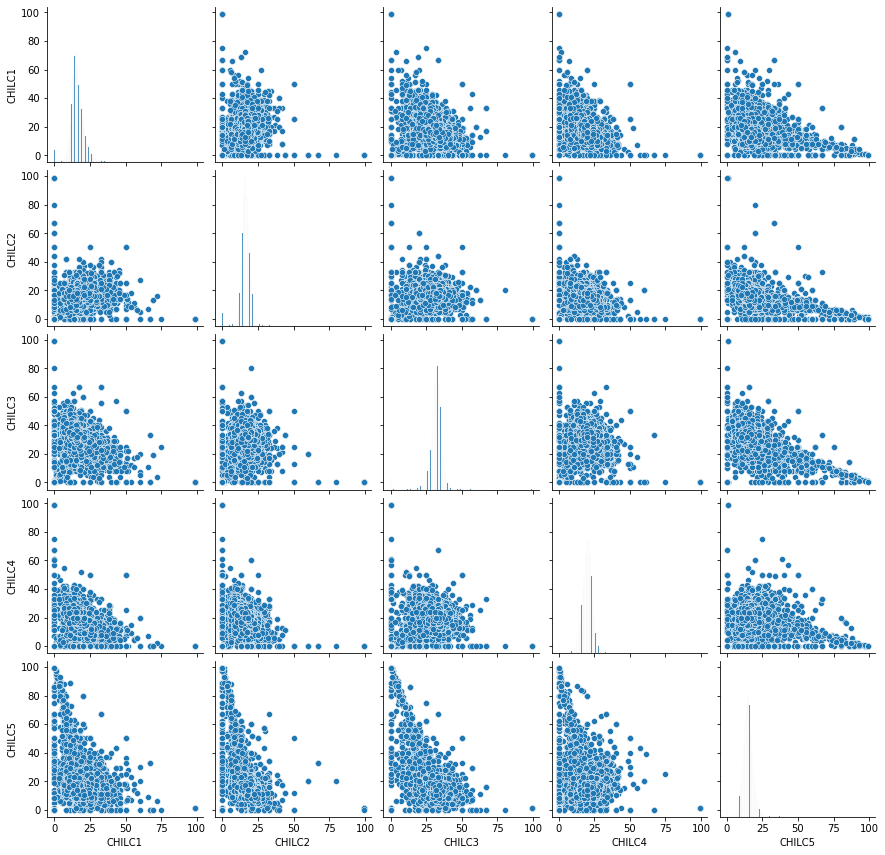

In [103]:
check_pairplot(dfraw, 'CHILC', 5)

['MARR1', 'MARR2', 'MARR3', 'MARR4']


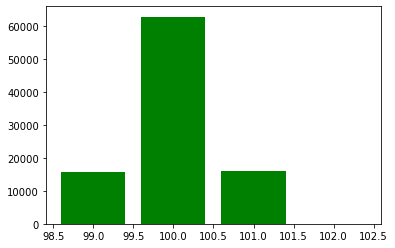

In [65]:
"""
MARR1                       Percent Married
MARR2                       Percent Separated or Divorced
MARR3                       Percent Widowed
MARR4                       Percent Never Married
"""

marr = percentage_validation(df, 'MARR', 4)

plotter(marr)

In [66]:
marr.value_counts()
fix_proportion(df, [98, 99, 101, 102], children, 'CHILC', 5)

In [67]:
fix_proportion(df, [99, 101, 102], marr, 'MARR', 4)

percentage_validation(df, 'MARR', 4).value_counts()

['MARR1', 'MARR2', 'MARR3', 'MARR4']


100.0    88736
100.0     4146
100.0     1642
100.0       83
100.0        6
dtype: int64

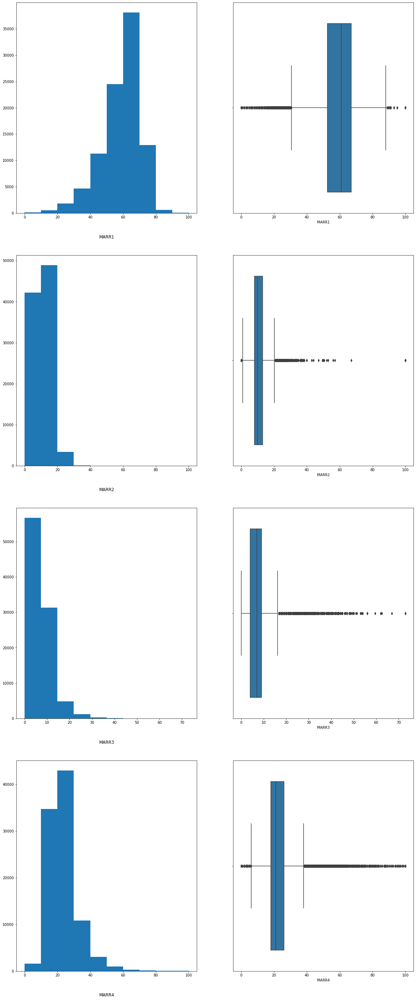

In [68]:
hist_box_plotting(df, 'MARR', 4)

In [69]:
#check_pairplot(dfraw, 'MARR', 4)

['IC6', 'IC7', 'IC8', 'IC9', 'IC10', 'IC11', 'IC12', 'IC13', 'IC14']


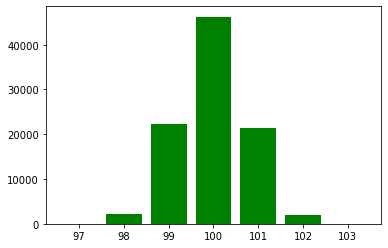

In [70]:
"""
IC6                         Percent Households w/ Income < $15,000
IC7                         Percent Households w/ Income $15,000 - $24,999
IC8                         Percent Households w/ Income $25,000 - $34,999
IC9                         Percent Households w/ Income $35,000 - $49,999
IC10                        Percent Households w/ Income $50,000 - $74,999
IC11                        Percent Households w/ Income $75,000 - $99,999
IC12                        Percent Households w/ Income $100,000 - $124,999
IC13                        Percent Households w/ Income $125,000 - $149,999
IC14                        Percent Households w/ Income >= $150,000
"""

households_incomes = percentage_validation(df, 'IC', 14, 6)

plotter(households_incomes)

In [71]:
households_incomes.value_counts()

100    46254
99     22401
101    21472
98      2277
102     2038
0         79
97        50
103       42
dtype: int64

In [72]:
fix_proportion(df, [97, 98, 99, 101, 102, 103], households_incomes, 'IC', 14, 6)

percentage_validation(df, 'IC', 14, 6).value_counts()

['IC6', 'IC7', 'IC8', 'IC9', 'IC10', 'IC11', 'IC12', 'IC13', 'IC14']


100.0    86550
100.0     4240
100.0     3675
0.0         79
100.0       49
100.0       20
dtype: int64

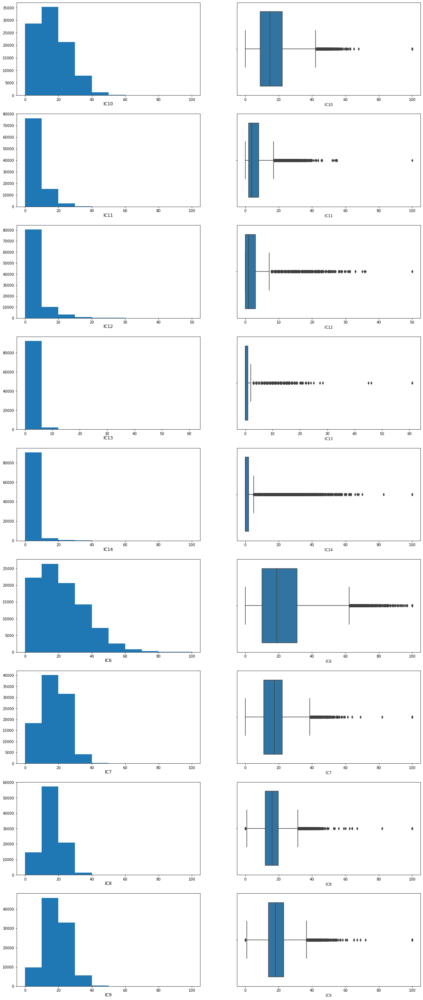

In [73]:
hist_box_plotting(df, 'IC', 14, 6)

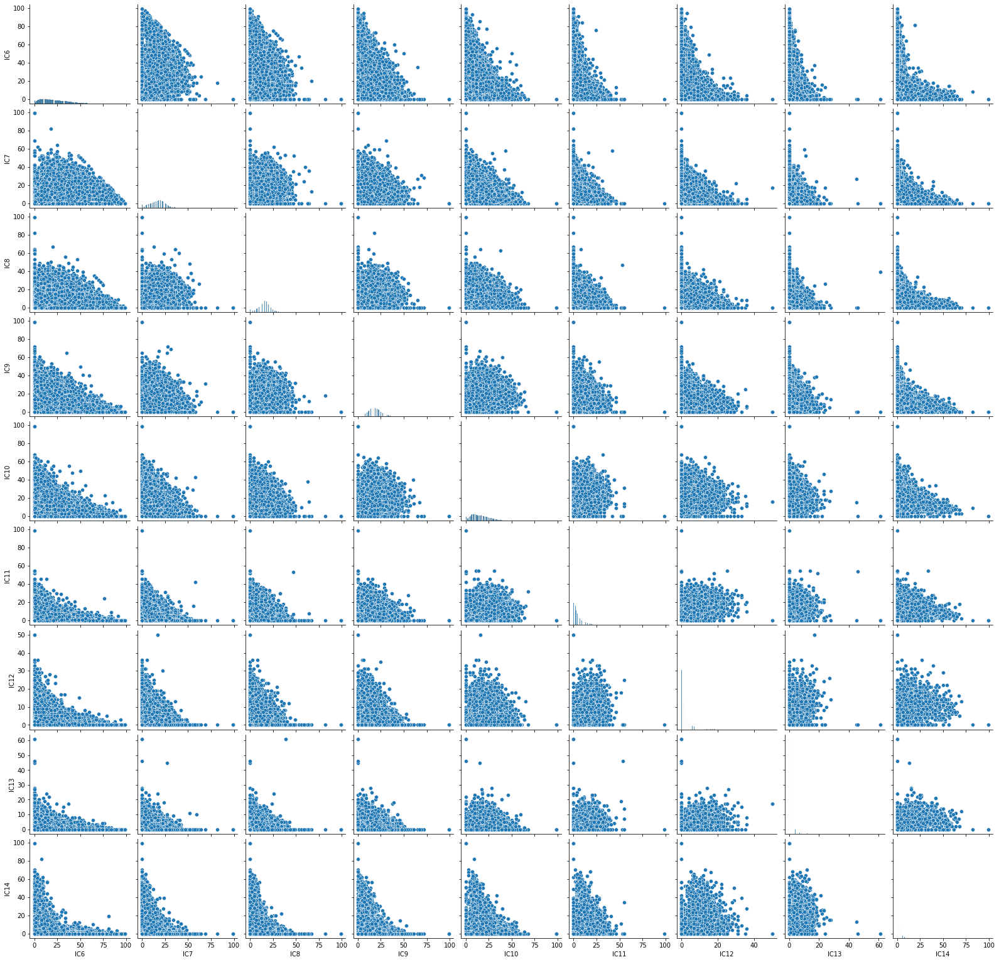

In [74]:
check_pairplot(dfraw, 'IC', 14, 6)

['IC15', 'IC16', 'IC17', 'IC18', 'IC19', 'IC20', 'IC21', 'IC22', 'IC23']


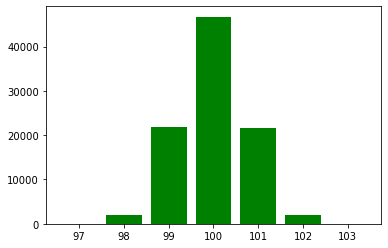

In [75]:
"""
IC15                        Percent Families w/ Income < $15,000
IC16                        Percent Families w/ Income $15,000 - $24,999
IC17                        Percent Families w/ Income $25,000 - 34,999
IC18                        Percent Families w/ Income $35,000 - $49,999
IC19                        Percent Families w/ Income $50,000 - $74,999
IC20                        Percent Families w/ Income $75,000 - $99,999
IC21                        Percent Families w/ Income $100,000 - $124,999
IC22                        Percent Families w/ Income $125,000 - $149,999
IC23                        Percent Families w/ Income >= $150,000
"""

fam_incomes = percentage_validation(df, 'IC', 23, 15)

plotter(fam_incomes)

In [76]:
fam_incomes.value_counts()

100    46742
99     21821
101    21695
98      2084
102     2061
0        129
103       42
97        39
dtype: int64

In [77]:
fix_proportion(df, [97, 98, 99, 101, 102, 103], fam_incomes, 'IC', 23, 15)

percentage_validation(df, 'IC', 23, 15).value_counts()

['IC15', 'IC16', 'IC17', 'IC18', 'IC19', 'IC20', 'IC21', 'IC22', 'IC23']


100.0    87102
100.0     4011
100.0     3294
0.0        129
100.0       70
100.0        7
dtype: int64

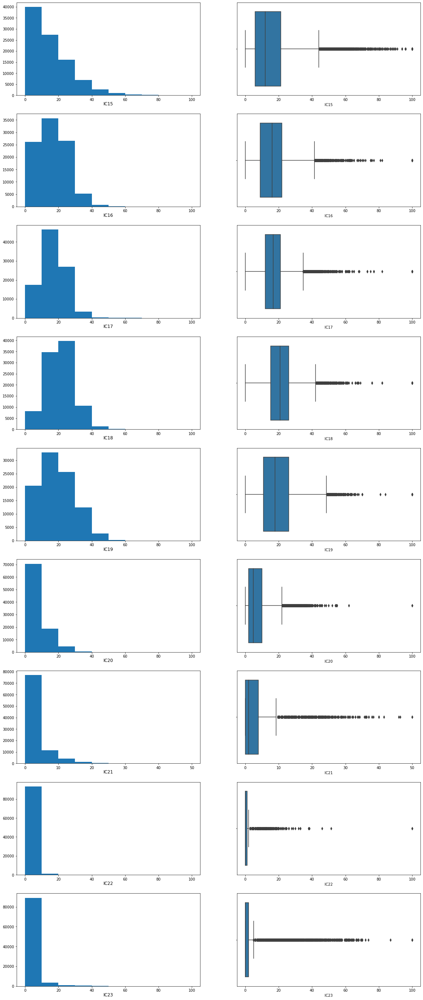

In [78]:
hist_box_plotting(df, 'IC', 23, 15)

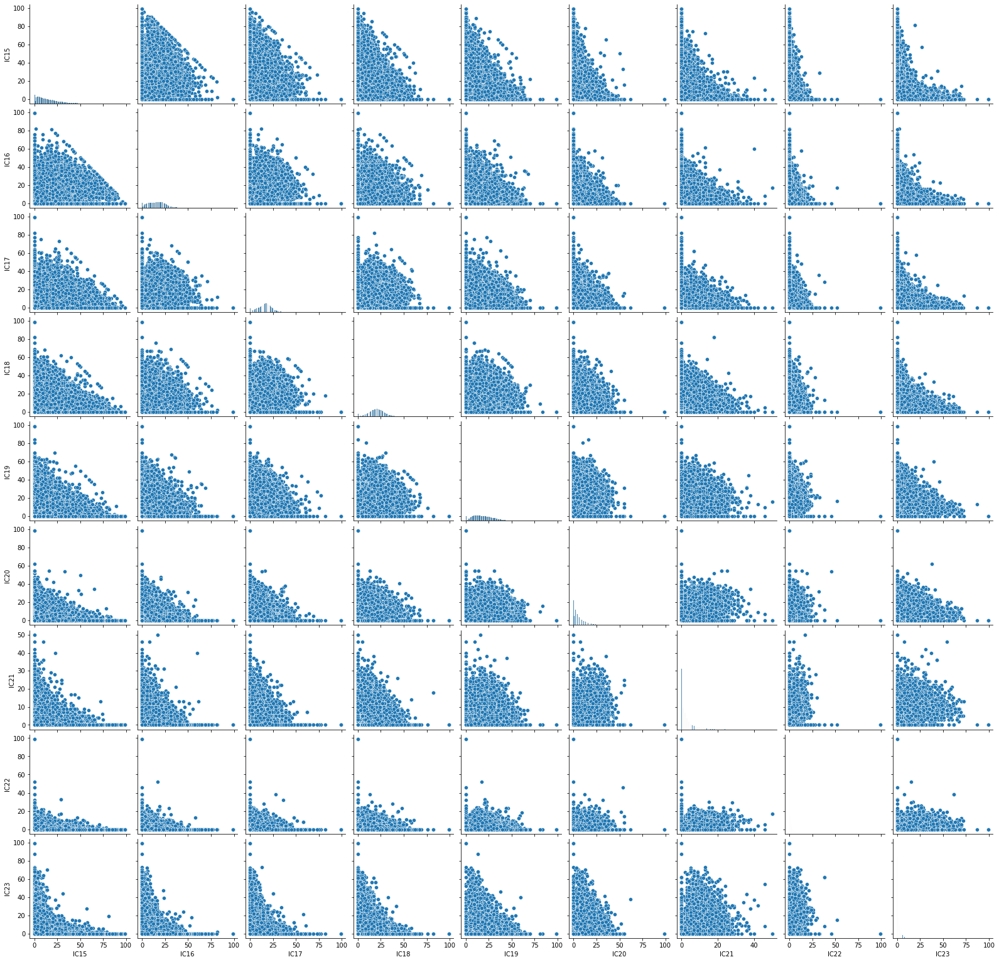

In [79]:
check_pairplot(dfraw, 'IC', 23, 15)

['TPE1', 'TPE2', 'TPE3', 'TPE4', 'TPE5', 'TPE6', 'TPE7', 'TPE8', 'TPE9']


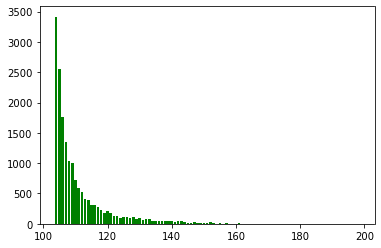

In [80]:
"""
TPE1                        Percent Driving to Work Alone Car/Truck/Van
TPE2                        Percent Carpooling Car/Truck/Van)
TPE3                        Percent Using Public Transportation
TPE4                        Percent Using Bus/Trolley
TPE5                        Percent Using Railways
TPE6                        Percent Using Taxi/Ferry
TPE7                        Percent Using Motorcycles
TPE8                        Percent Using Other Transportation
TPE9                        Percent Working at Home/No Transportation
"""

transp = percentage_validation(df, 'TPE', 9)

transp = transp[transp>103]

plotter(transp, False)

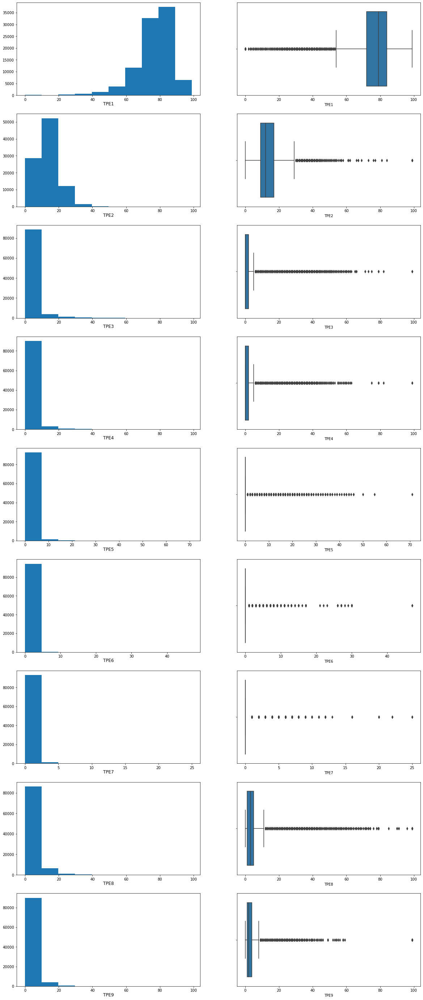

In [81]:
hist_box_plotting(df, 'TPE', 9)

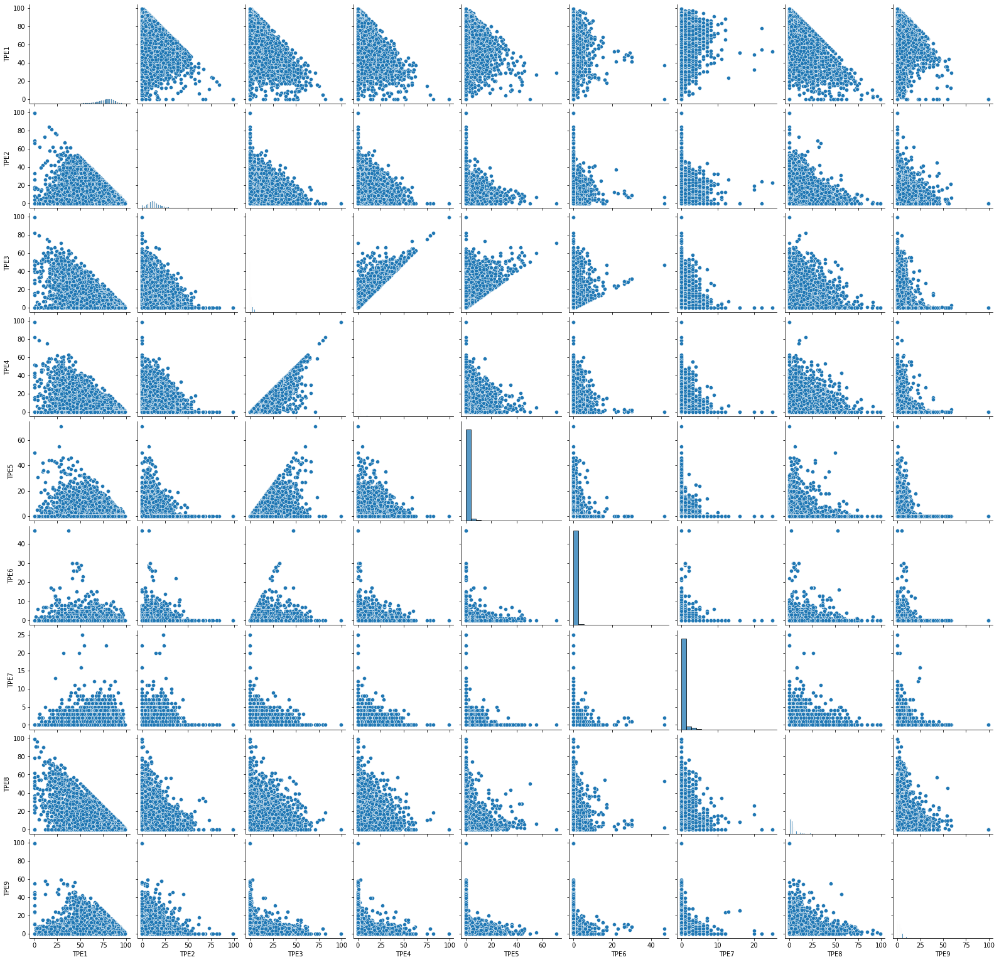

In [82]:
check_pairplot(dfraw, 'TPE', 9)

['SEC1', 'SEC2', 'SEC3', 'SEC4', 'SEC5']


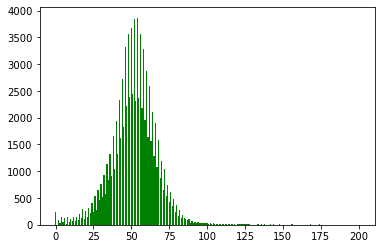

In [83]:
"""
SEC1                        Percent Persons Enrolled in Private Schools
SEC2                        Percent Persons Enrolled in Public Schools
SEC3                        Percent Persons Enrolled in Preschool
SEC4                        Percent Persons Enrolled in Elementary or High School
SEC5                        Percent Persons in College
"""

school = percentage_validation(df, 'SEC', 5)

#school = school[school>100]
plotter(school, False)

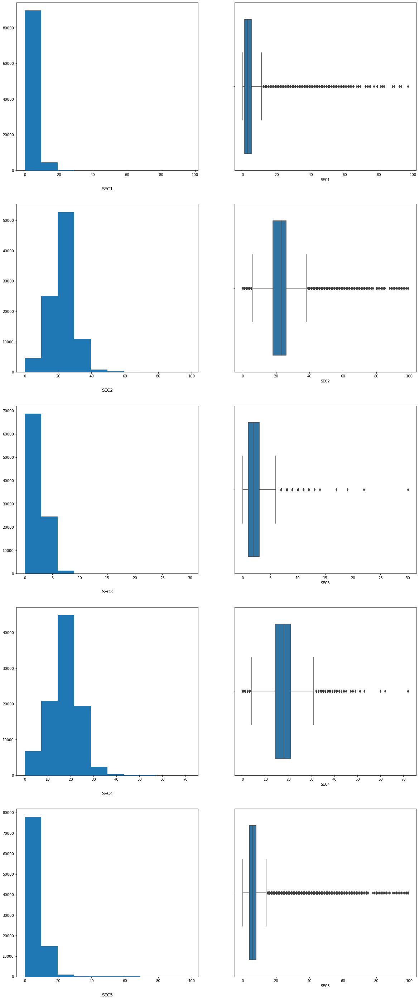

In [84]:
hist_box_plotting(df, 'SEC', 5) 

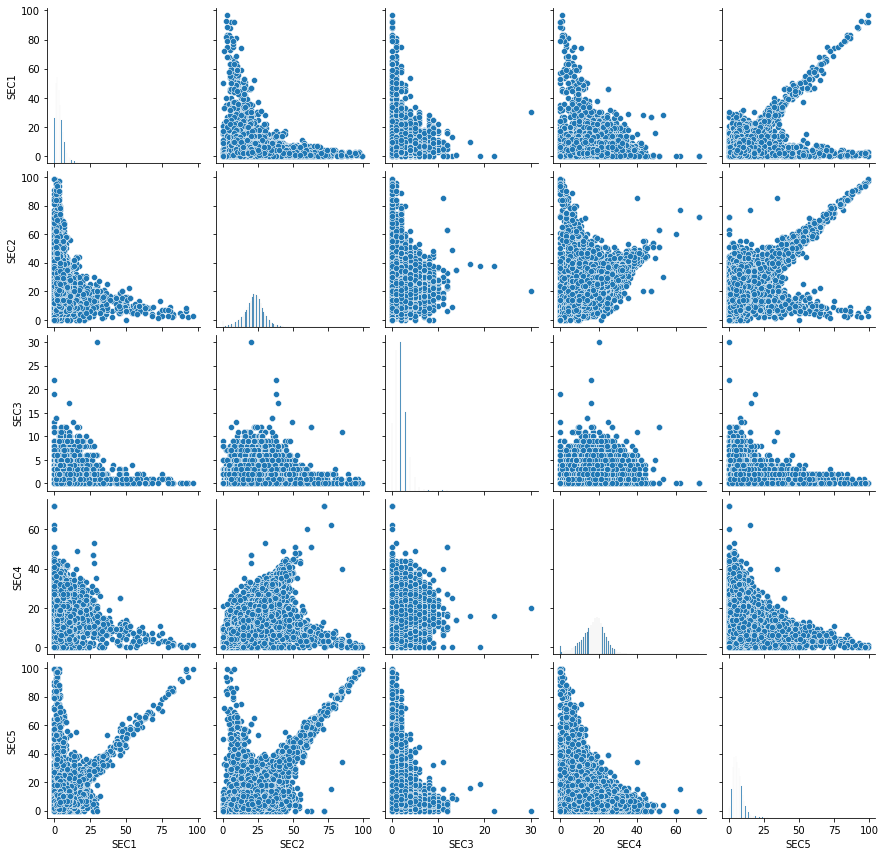

In [85]:
check_pairplot(dfraw, 'SEC', 5)

['LFC2', 'LFC3']


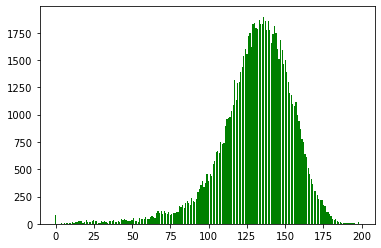

In [86]:
#LFC1                        Percent Adults in Labor Force
#LFC2                        Percent Adult Males in Labor Force
#LFC3                        Percent Females in Labor Force

labor = percentage_validation(df, 'LFC', 3, 2)

plotter(labor, False)

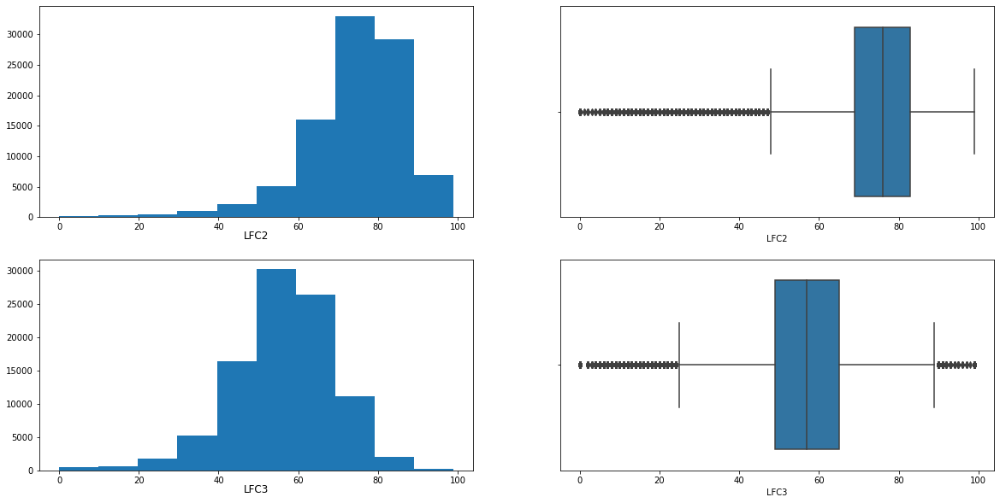

In [87]:
hist_box_plotting(df, 'LFC', 3, 2)

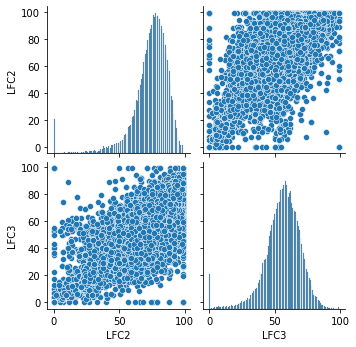

In [88]:
check_pairplot(dfraw, 'LFC', 3, 2)

['LSC1', 'LSC2', 'LSC3', 'LSC4']


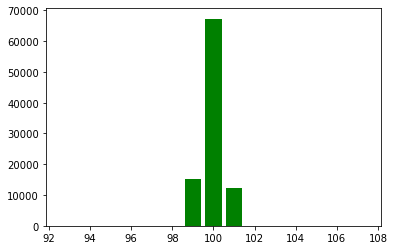

In [89]:
# LSC1                        Percent English Only Speaking
# LSC2                        Percent Spanish Speaking
# LSC3                        Percent Asian Speaking
# LSC4                        Percent Other Language Speaking

lang = percentage_validation(df, 'LSC', 4)

#lang = lang[lang <= 98]
plotter(lang)

In [90]:
lang.value_counts()

100    67236
99     15174
101    12121
0         52
98        16
102        7
97         4
107        2
93         1
dtype: int64

In [91]:
fix_proportion(df, [93, 97, 98, 99, 101, 102, 107], lang, 'LSC', 4)

percentage_validation(df, 'LSC', 4).value_counts()

['LSC1', 'LSC2', 'LSC3', 'LSC4']


100.0    88468
100.0     3546
100.0     2498
0.0         52
100.0       35
100.0       14
dtype: int64

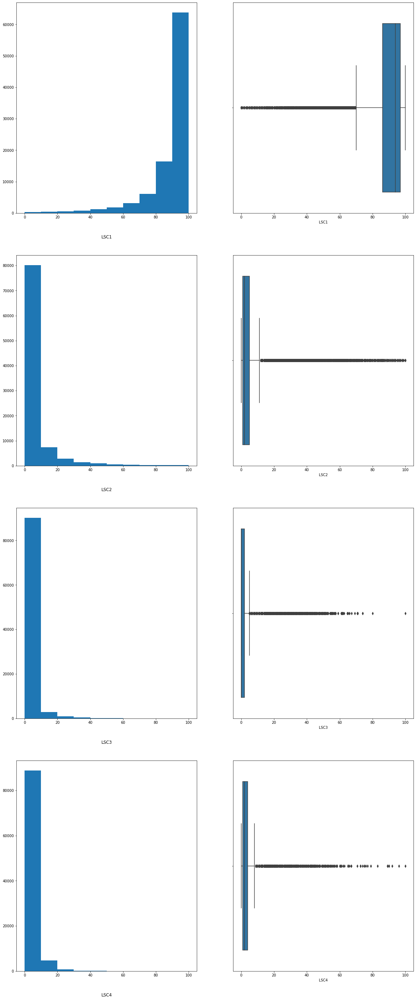

In [92]:
hist_box_plotting(df, 'LSC', 4)

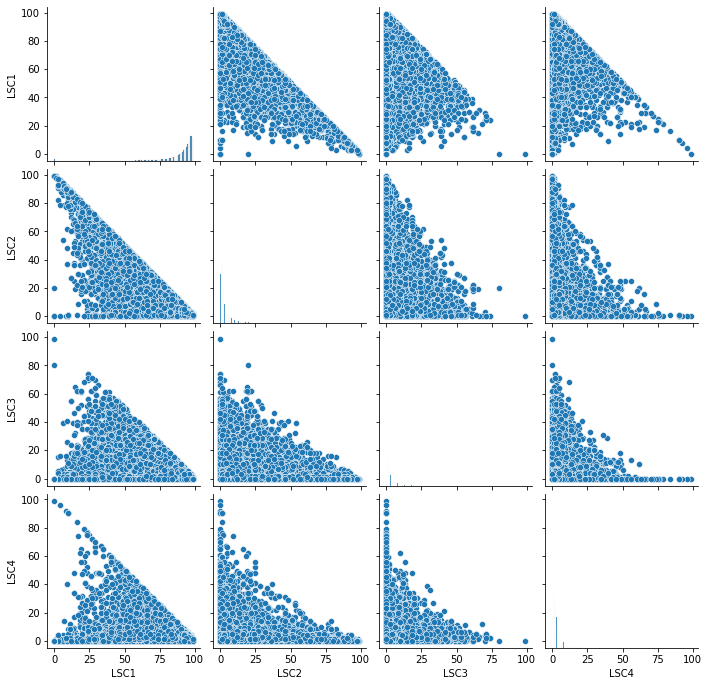

In [93]:
check_pairplot(dfraw, 'LSC', 4)

['POBC1', 'POBC2']


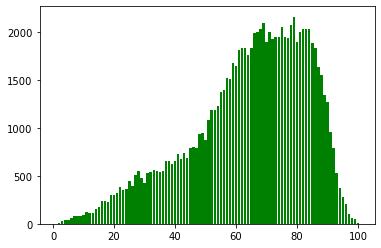

In [94]:
#POBC1                       Percent Foreign Born
#POBC2                       Percent Born in State of Residence

birth = percentage_validation(df, 'POBC', 2)

plotter(birth)

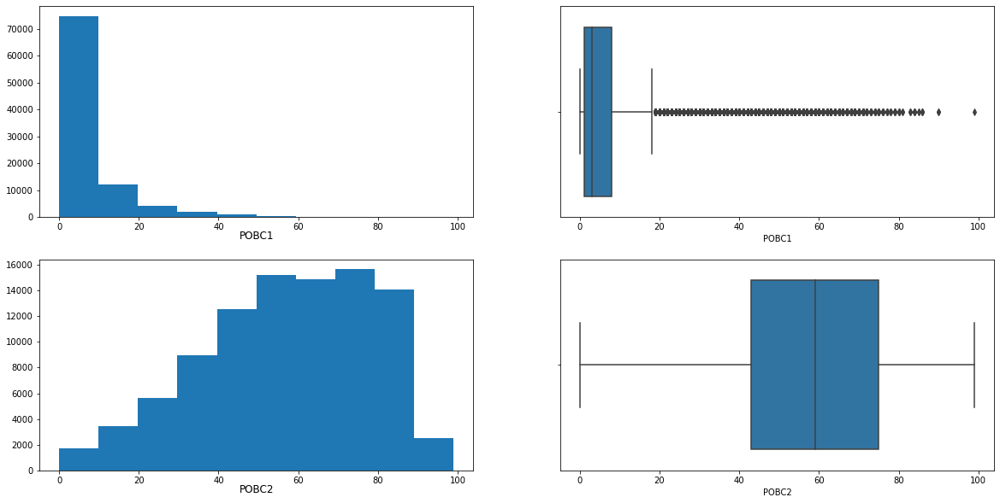

In [95]:
hist_box_plotting(df, 'POBC', 2)

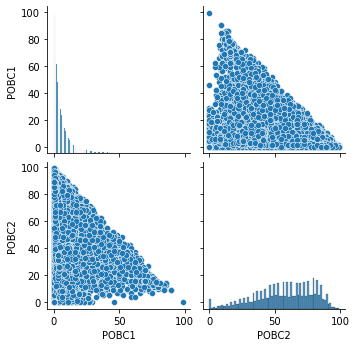

In [96]:
check_pairplot(dfraw, 'POBC', 2)

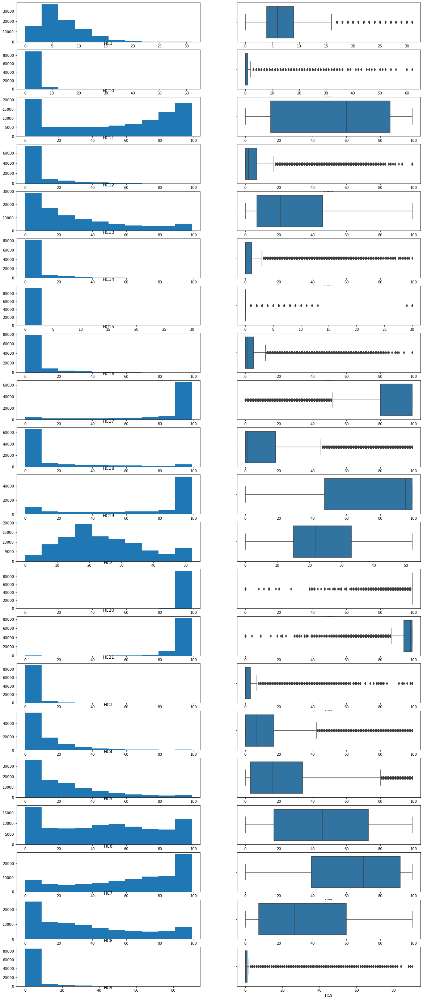

In [97]:
"""
HC1                         Percent Median Length of Residence
HC2                         Percent Median Age of Occupied Dwellings in years
HC3                         Percent Owner Occupied Structures Built Since 2009
HC4                         Percent Owner Occupied Structures Built Since 2005
HC5                         Percent Owner Occupied Structures Built Since 2000
HC6                         Percent Owner Occupied Structures Built Since 1990
HC7                         Percent Owner Occupied Structures Built Since 1980
HC8                         Percent Owner Occupied Structures Built Prior to 1860
HC9                         Percent Owner Occupied Condominiums
HC10                        Percent Renter Occupied Condominiums
HC11                        Percent Occupied Housing Units Heated by Utility Gas
HC12                        Percent Occupied Housing Units Heated by Bottled, Tank or LP
HC13                        Percent Occupied Housing Units Heated by Electricity
HC14                        Percent Occupied Housing Units Heated by Fuel Oil
HC15                        Percent Occupied Housing Units Heated by Solar Energy
HC16                        Percent Occupied Housing Units Heated by Coal, Wood, Other
HC17                        Percent Housing Units w/ Public Water Source
HC18                        Percent Housing Units w/ Well Water Source
HC19                        Percent Housing Units w/ Public Sewer Source
HC20                        Percent Housing Units w/ Complete Plumbing Facilities
HC21                        Percent Housing Units w/ Telephones
"""

hist_box_plotting(df, 'HC', 21)

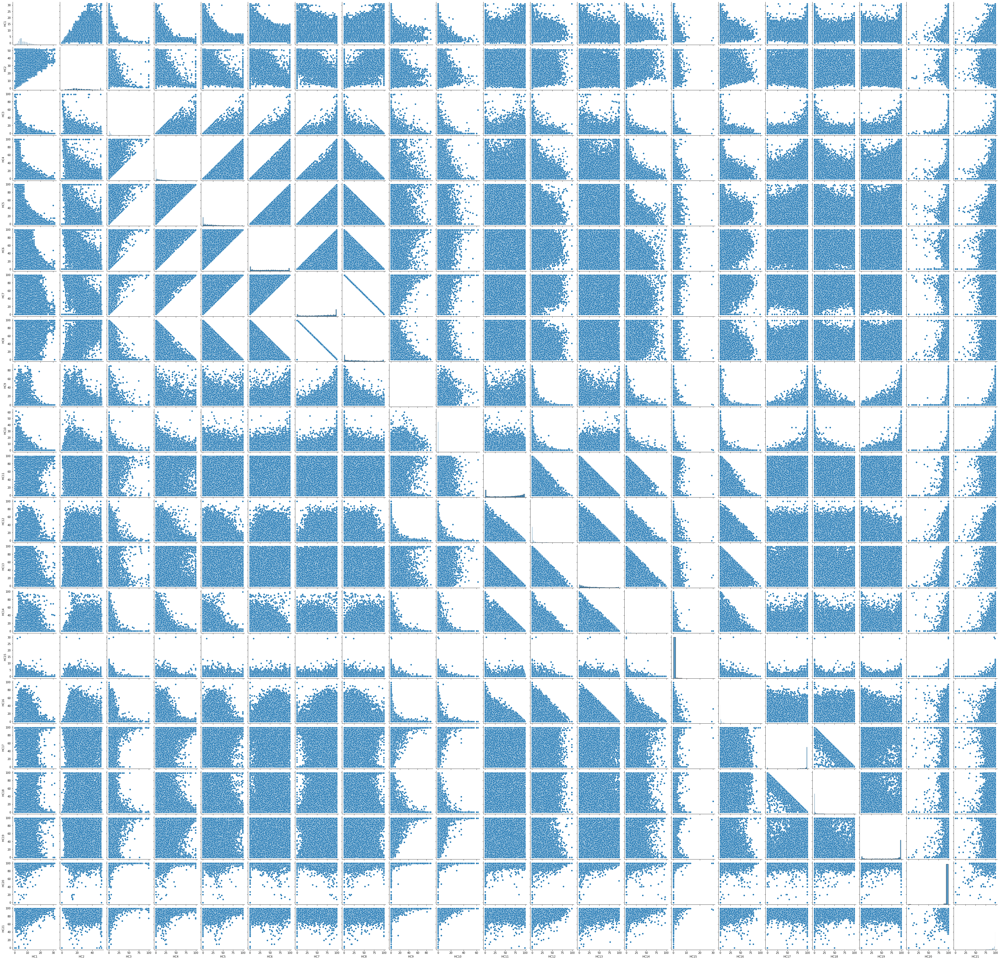

In [98]:
check_pairplot(dfraw, 'HC', 21)

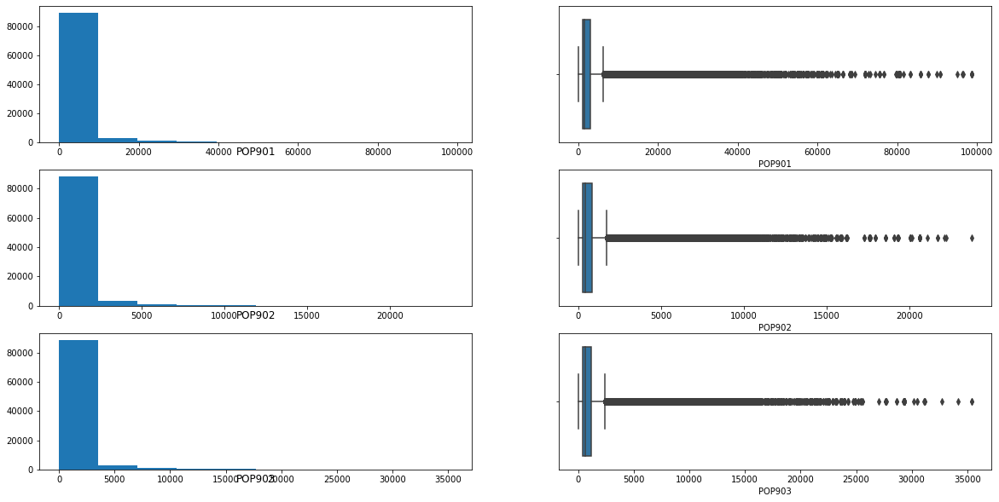

In [99]:
"""
POP901                      Number of Persons
POP902                      Number of Families
POP903                      Number of Households
"""

hist_box_plotting(df, 'POP90', 3)

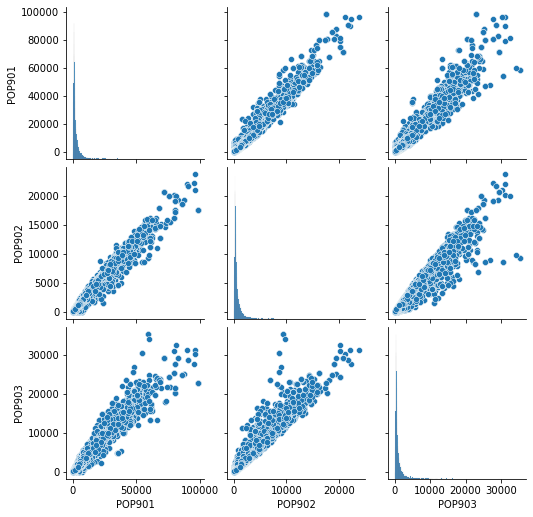

In [100]:
check_pairplot(df, 'POP90', 3)

Let's save our cleaned dataframe into a variable:

In [101]:
print( 'Proportion of records remaining from the original data: ', len(df)/len(dfraw) )

Proportion of records remaining from the original data:  0.9916257913050769


In [102]:
df.to_csv('pre_processed_data.csv', index = False)